### requirements

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
from google.colab.patches import cv2_imshow

def plot_two_images(img1: np.array, img2: np.array, leg1="", leg2=""):
    _, ax = plt.subplots(1, 2, figsize=(20, 16))
    ax[0].imshow(img1, cmap='gray')
    ax[1].imshow(img2, cmap='gray')
    ax[0].set_title(leg1)
    ax[1].set_title(leg2)

def plot_side_by_side(image1, image2):
    fig, ax = plt.subplots(1, 2, figsize=(16, 8))
    ax[0].imshow(image1)
    ax[1].imshow(image2)
    # ax[0].axis('off')
    # ax[1].axis('off')
    ax[0].set_title("Original")
    ax[1].set_title("Com filtro")
    plt.show()

In [ ]:
!git clone https://github.com/denilsonB/visao_computacional.git

Cloning into 'visao_computacional'...
remote: Enumerating objects: 10, done.
remote: Counting objects: 100% (10/10), done.
remote: Compressing objects: 100% (8/8), done.
remote: Total 10 (delta 0), reused 0 (delta 0), pack-reused 0
Receiving objects: 100% (10/10), 9.85 MiB | 2.40 MiB/s, done.


### **1.** Implemente uma funcão que receba uma imagem em formato PPM,
o tamanho n de um filtro espacial com dimens ̃oes n × n e a matriz com os
pesos do filtro, e aplique o filtro com uma convolu ̧cão, gerando e salvando **a**
imagem resultante no disco em formato PPM. Você não pode usar a OpenCV em nenhum desses passos. As especificacões do formato PPM podem ser en-
contradas aqui: https://netpbm.sourceforge.net/doc/ppm.html

Código

In [ ]:
def readPPM(imagePath):
  with open(imagePath, "r") as f:
    imageList = f.read().splitlines()

  header = [line for line in imageList if not line.startswith('#')]
  ppmType = header.pop(0)
  ppmColumns, ppmLines = map(int, header.pop(0).split())
  ppmMaxValue = int(header.pop(0))

  values = np.array(list(map(int, ' '.join(header).split())))
  img_matrix = np.reshape(values, (ppmLines, ppmColumns, 3))

  return ppmColumns, ppmLines, ppmMaxValue, img_matrix

def turn_to_PPM(ppmMaxValue, img_matrix, PPM_path):
  with open(PPM_path, 'w') as f:
      f.write(f'P3\n{img_matrix.shape[1]} {img_matrix.shape[0]}\n255\n')

      np.savetxt(f, img_matrix.reshape(-1, 3), fmt='%d')

def conv(imagePPM, n, weights_filter, high_pass_filter = 0):
  ppmColumns, ppmLines, ppmMaxValue, img_matrix = readPPM(imagePPM)

  pad = n // 2
  img_padded = np.pad(img_matrix, ((pad, pad), (pad, pad), (0, 0)), 'edge')

  result = np.zeros(shape=img_padded.shape)

  for k in range(img_padded.shape[2]):
    channel_padded = img_padded[:, :, k]
    channel_result = np.zeros_like(channel_padded)

    for i in range(img_padded.shape[0]):
      for j in range(img_padded.shape[1]):
        patch = channel_padded[i:i + n, j:j + n]
        if patch.shape == weights_filter.shape:
          channel_result[i + pad, j + pad] = np.sum(patch * weights_filter)

    result[:, :, k] = channel_result

  if high_pass_filter == 1:
    result = result[pad:-pad, pad:-pad, :].astype("uint8")

    return img_matrix, result, ppmMaxValue

  result = np.clip(result[pad:-pad, pad:-pad, :], 0, 255).astype("uint8")

  return img_matrix, result, ppmMaxValue

def conv_filter(imagePPM, n, weights_filter, high_pass_filter = 0, PPM_path = None):
  img_matrix, result, ppmMaxValue = conv(imagePPM, n, weights_filter, high_pass_filter)

  if PPM_path is not None:
    turn_to_PPM(ppmMaxValue, result, PPM_path)

  plot_side_by_side(img_matrix, result)

### **Exemplo 1** - Filtro identidade

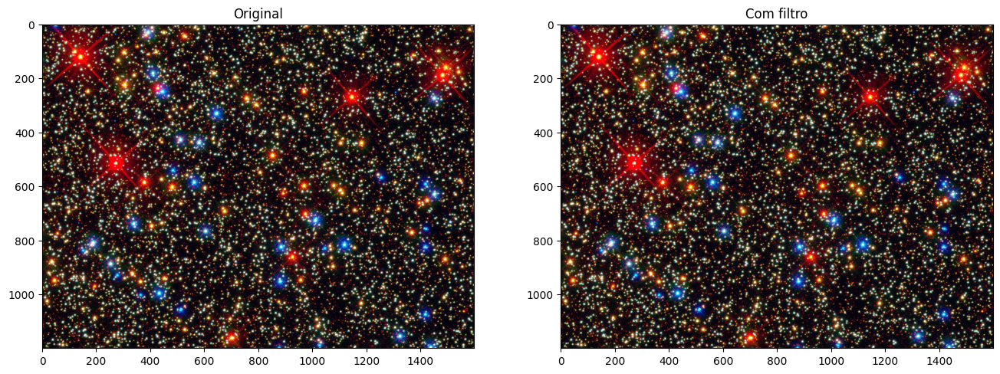

In [ ]:
weight = np.array([[0, 0, 0],
                   [0, 1, 0],
                   [0, 0, 0]])

conv_filter('/content/visao_computacional/lista1/stars.ppm', weight.shape[0], weight, '/content/sample_data/exemplo1.ppm')

### **Exemplo 2** - Efeito blur

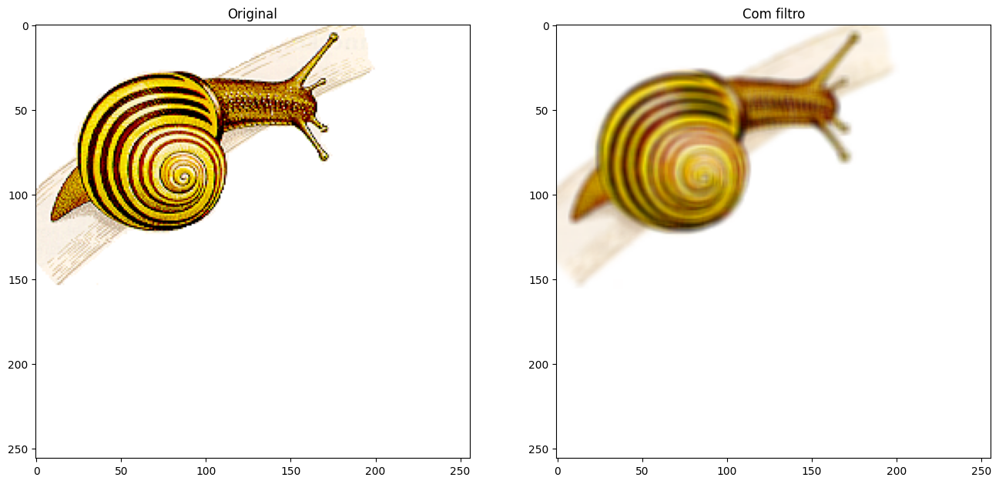

In [ ]:
weight = np.array([[1/25, 1/25, 1/25, 1/25, 1/25],
                   [1/25, 1/25, 1/25, 1/25, 1/25],
                   [1/25, 1/25, 1/25, 1/25, 1/25],
                   [1/25, 1/25, 1/25, 1/25, 1/25],
                   [1/25, 1/25, 1/25, 1/25, 1/25]])

conv_filter('/content/visao_computacional/lista1/snail.ppm', weight.shape[0], weight, '/content/sample_data/exemplo2.ppm')

### 2. Usando a funcão da questão 1, pesquise um filtro passa-alta e aplique-o em 3 imagens distintas, variando o valor de n em 3 unidades em cada imagem. O que acontece quando n cresce?

In [ ]:
def high_pass_filter(n):
    delta = np.zeros((n, n))
    delta[n//2, n//2] = 1

    cutoff = 0.5
    x, y = np.meshgrid(np.linspace(-1, 1, n), np.linspace(-1, 1, n))
    radius = np.sqrt(x**2 + y**2)
    lowpass_kernel = np.exp(-(radius/cutoff)**2)
    lowpass_kernel = lowpass_kernel / np.sum(lowpass_kernel)

    kernel = lowpass_kernel - delta

    return kernel

Ao crescer o valor de  n  do Filtro Passa-Alta, aumenta também a quantidade de detalhes na imagem resultante, sejam eles componentes de alta frequência, como bordas, por exemplo, o que é uma característica importante do uso de Filtros Passa-Alta numa imagem, o qual é util quando é necessário acentuar os componentes e alta frequência e reduzir as variações suaves de baixa frequência.

Porém, como exemplo na última imagem, notou-se em alguns aspectos o quão ruidosa algumas partes da imagem resultante ficou, já que o Filtro Passa-Alta pode ocasionar uma ampliação de qualquer ruído já presente na imagem.

### **Imagem 1**

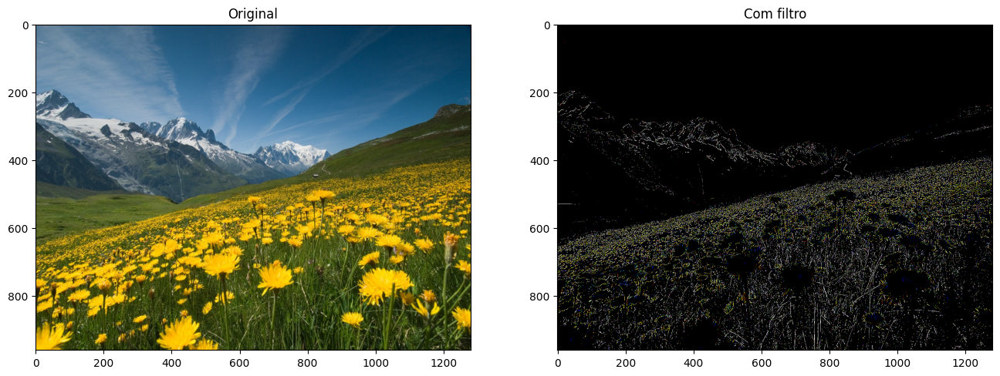

In [ ]:
conv_filter('/content/visao_computacional/lista1/flowers.ppm', 3, high_pass_filter(3), 1)

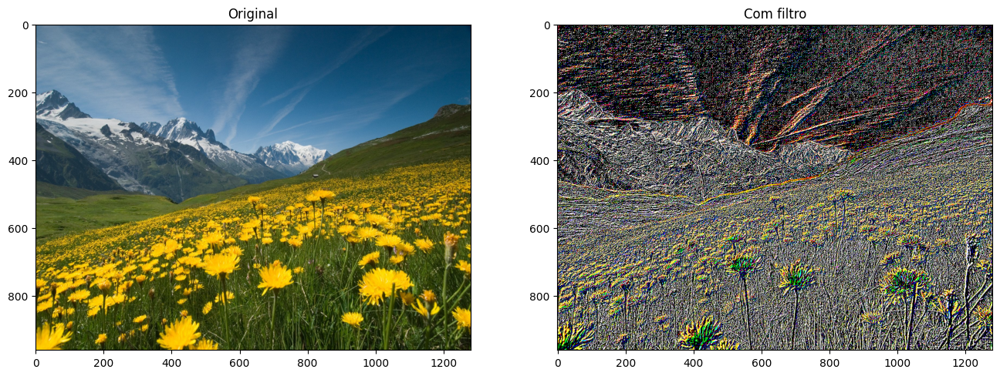

In [ ]:
conv_filter('/content/visao_computacional/lista1/flowers.ppm', 6, high_pass_filter(6), 1)

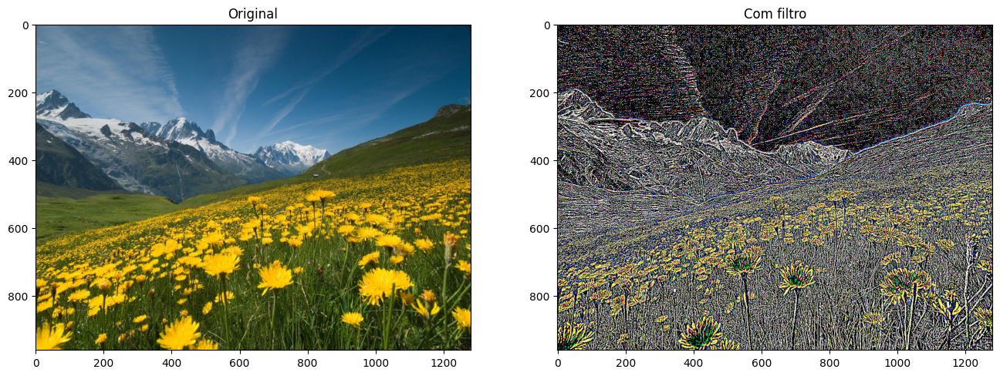

In [ ]:
conv_filter('/content/visao_computacional/lista1/flowers.ppm', 9, high_pass_filter(9), 1)

### **Imagem 2**

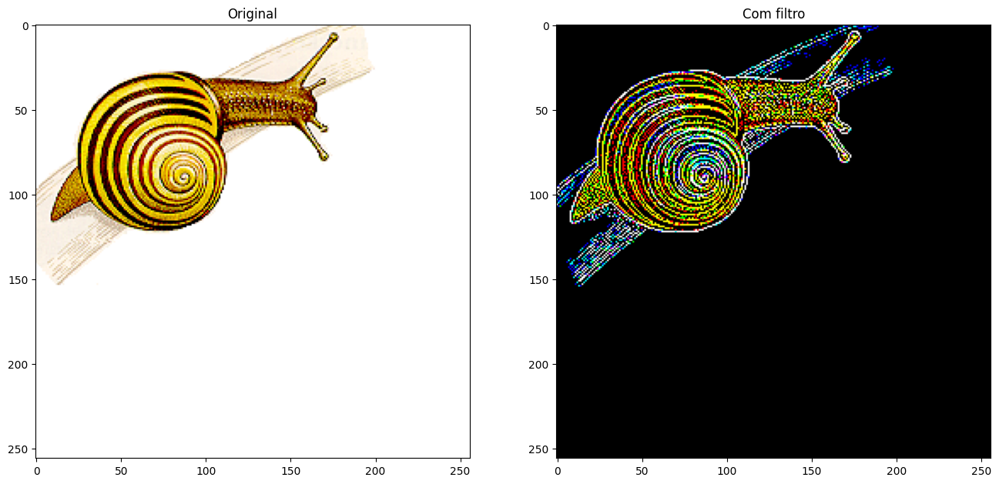

In [ ]:
conv_filter('/content/visao_computacional/lista1/snail.ppm', 3, high_pass_filter(3), 1)

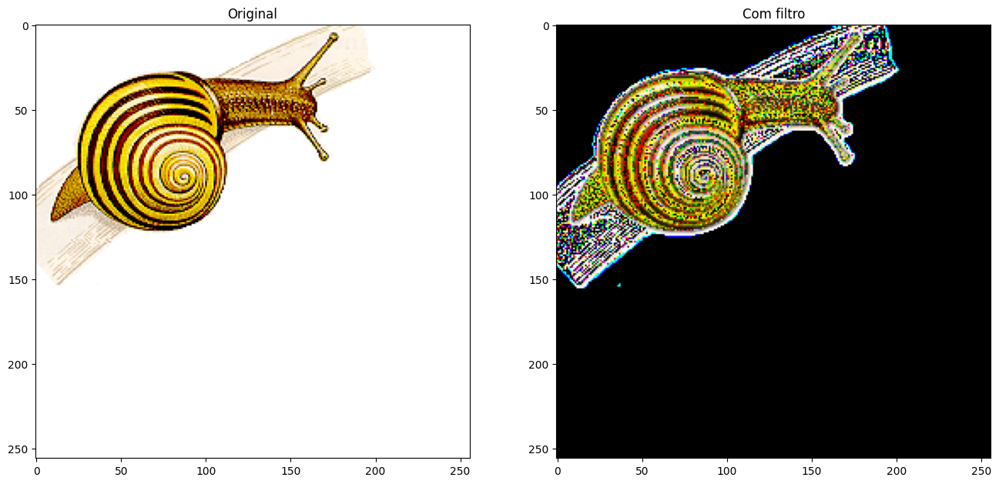

In [ ]:
conv_filter('/content/visao_computacional/lista1/snail.ppm', 6, high_pass_filter(6), 1)

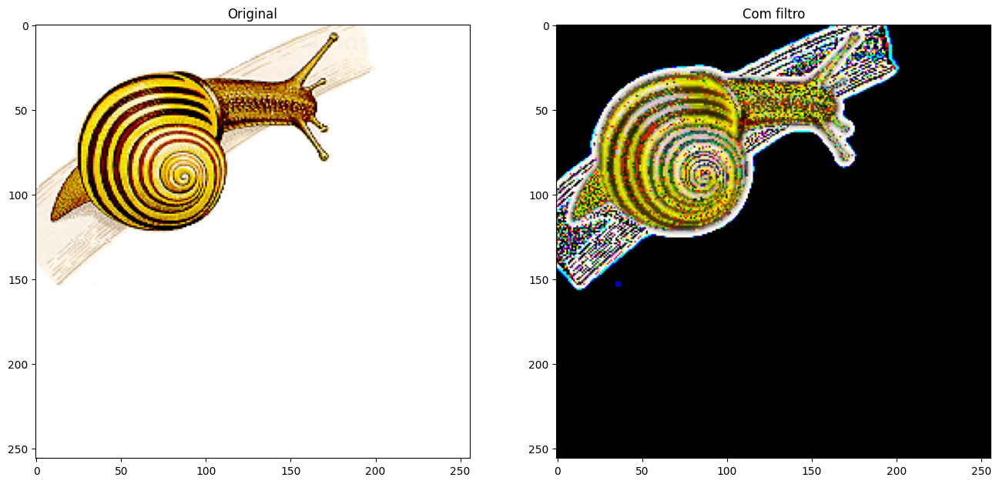

In [ ]:
conv_filter('/content/visao_computacional/lista1/snail.ppm', 9, high_pass_filter(9), 1)

### **Imagem 3**

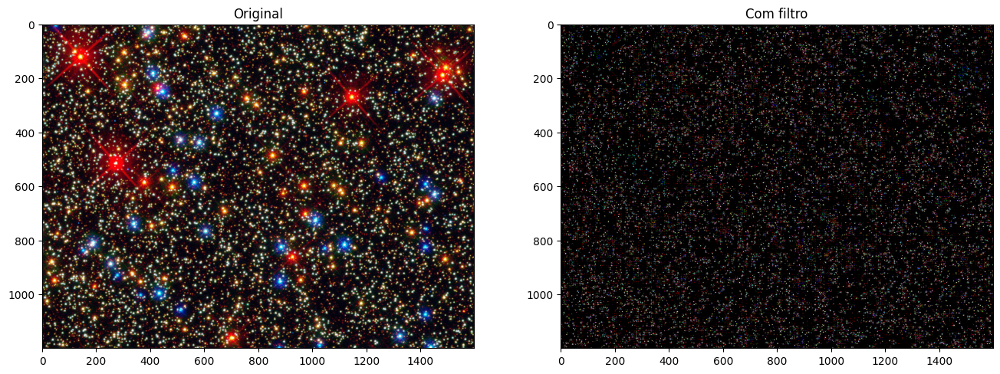

In [ ]:
conv_filter('/content/visao_computacional/lista1/stars.ppm', 3, high_pass_filter(3), 1)

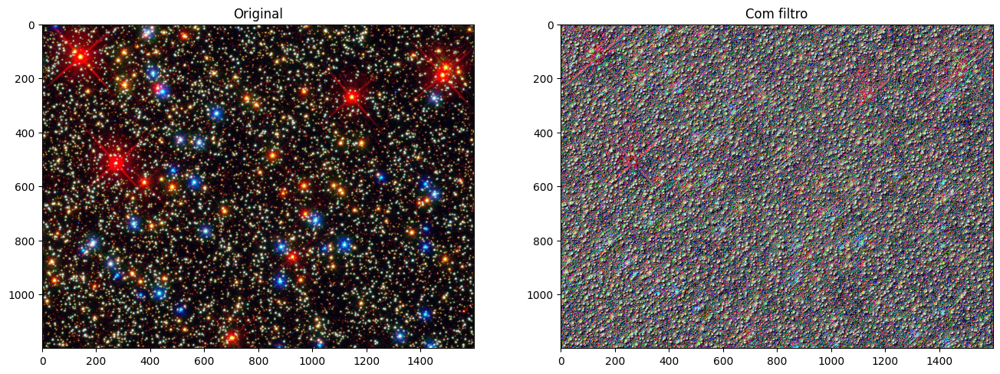

In [ ]:
conv_filter('/content/visao_computacional/lista1/stars.ppm', 6, high_pass_filter(6), 1)

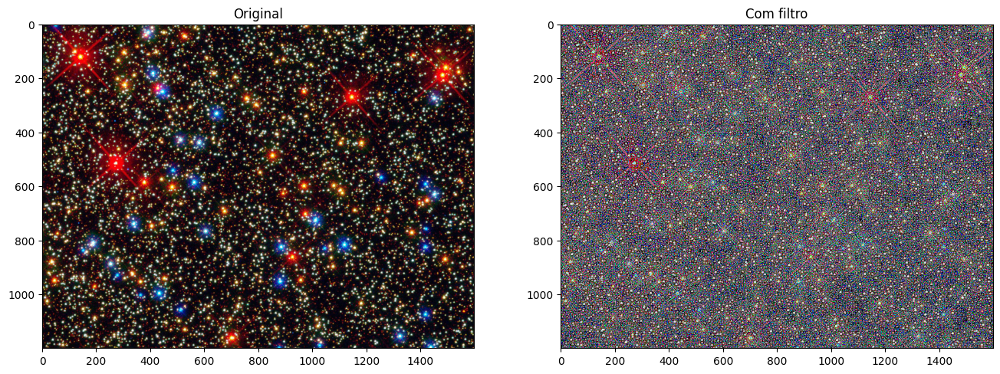

In [ ]:
conv_filter('/content/visao_computacional/lista1/stars.ppm', 9, high_pass_filter(9), 1)

### **3.** Usando a funcão da questão 1, pesquise um filtro passa-baixa e aplique-o em 3 imagens distintas, variando o valor de n em 3 unidades em cada imagem. O que acontece quando n cresce?

In [ ]:
def low_pass_filter(n):
    x, y = np.meshgrid(np.linspace(-1, 1, n), np.linspace(-1, 1, n))
    radius = np.sqrt(x**2 + y**2)
    cutoff = 0.5
    kernel = np.exp(-(radius/cutoff)**2)

    kernel = kernel / np.sum(kernel)

    return kernel

Percebe-se que, ao crescer o valor de  n  do Filtro Passa-Baixa, aumenta também a suavização e redução de ruído na imagem resultante. Já que o Filtro Passa-Baixa atua reduzindo as componentes de alta frequência e mantedo as de baixa frequência, o que é notório nos exemplos abaixo, em que as imagens ficaram mais borradas e menos granuladas, havendo a perda de detalhes e texturas da imagem original.

### **Imagem 1**

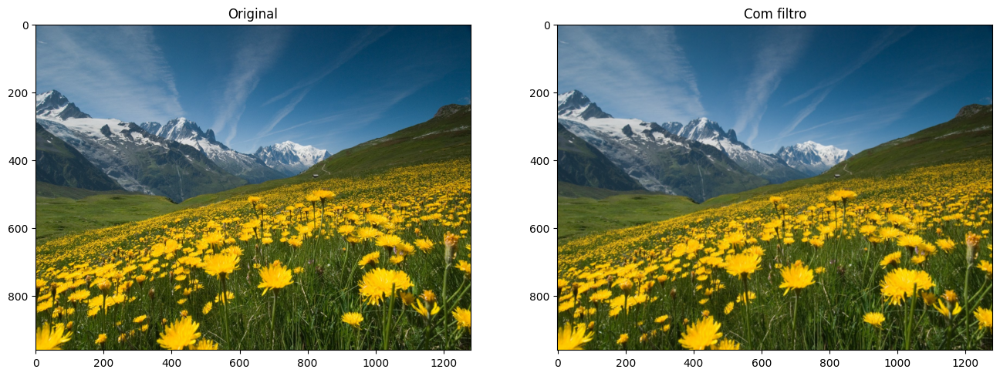

In [ ]:
conv_filter('/content/visao_computacional/lista1/flowers.ppm', 5, low_pass_filter(5))

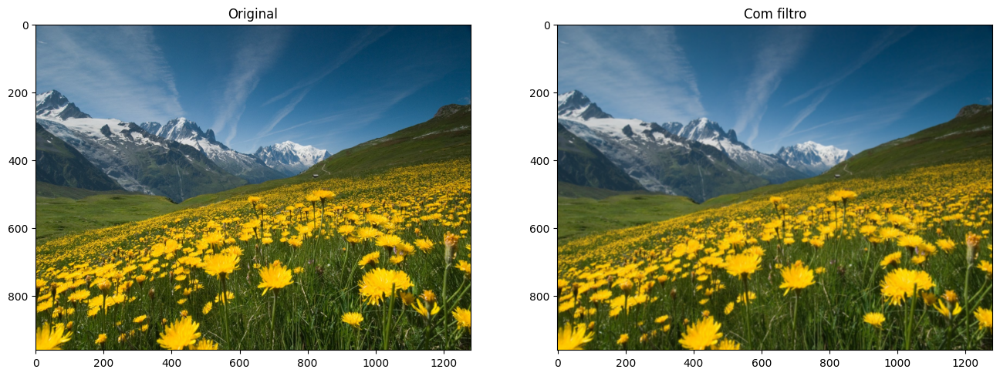

In [ ]:
conv_filter('/content/visao_computacional/lista1/flowers.ppm', 8, low_pass_filter(8))

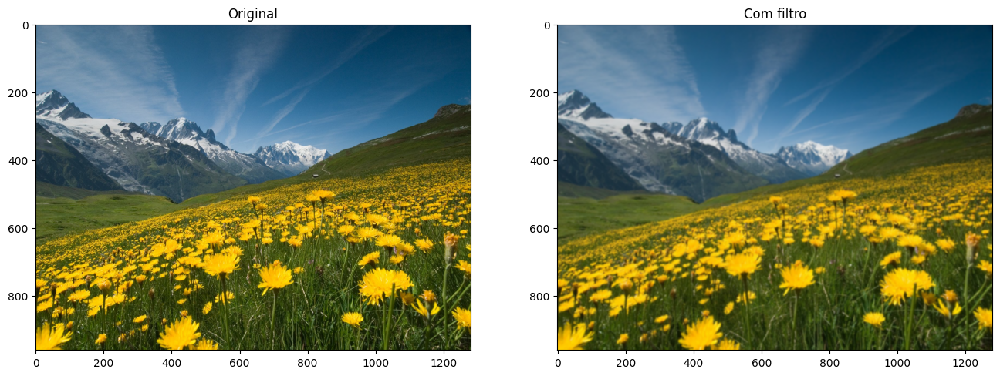

In [ ]:
conv_filter('/content/visao_computacional/lista1/flowers.ppm', 11, low_pass_filter(11))

### **Imagem 2**

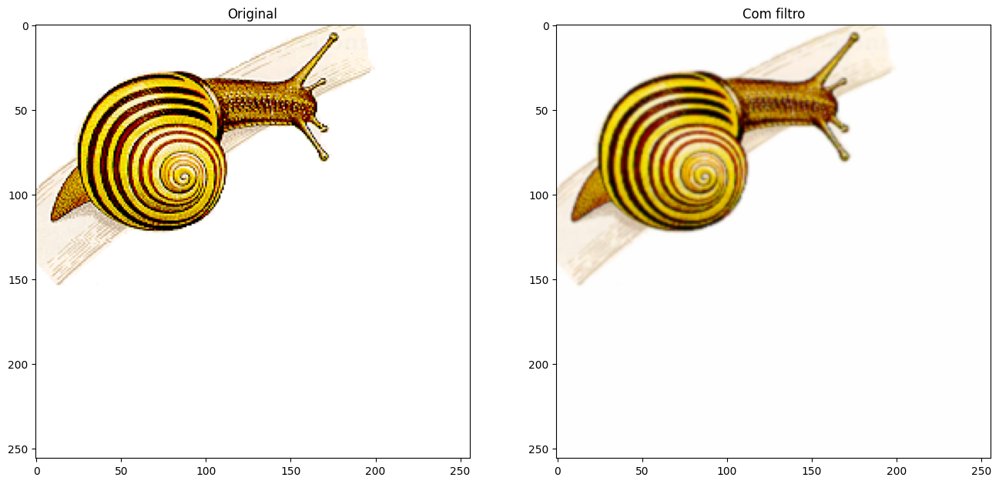

In [ ]:
conv_filter('/content/visao_computacional/lista1/snail.ppm', 5, low_pass_filter(5))

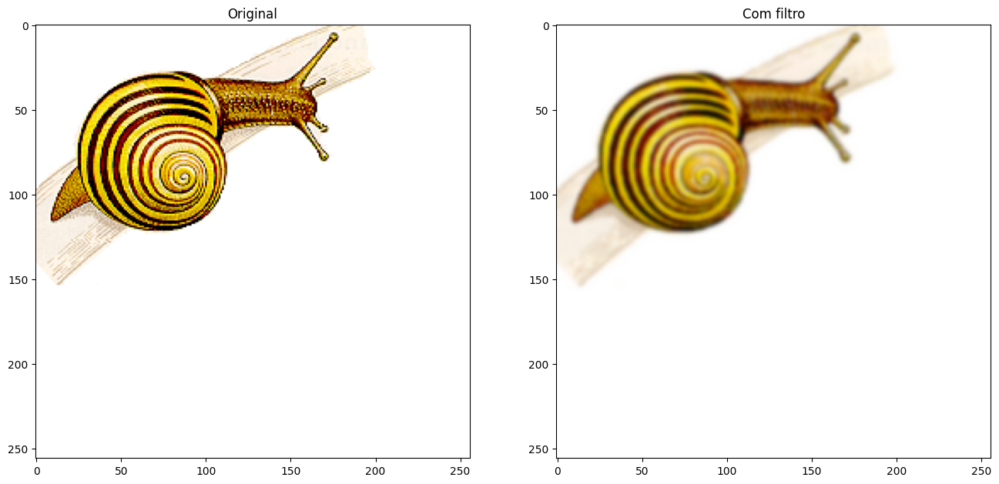

In [ ]:
conv_filter('/content/visao_computacional/lista1/snail.ppm', 8, low_pass_filter(8))

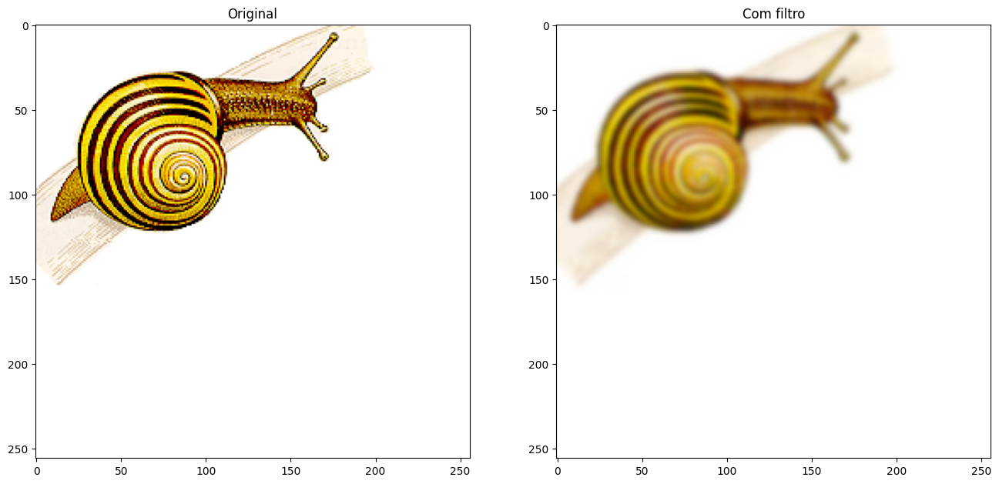

In [ ]:
conv_filter('/content/visao_computacional/lista1/snail.ppm', 11, low_pass_filter(11))

### **Imagem 3**

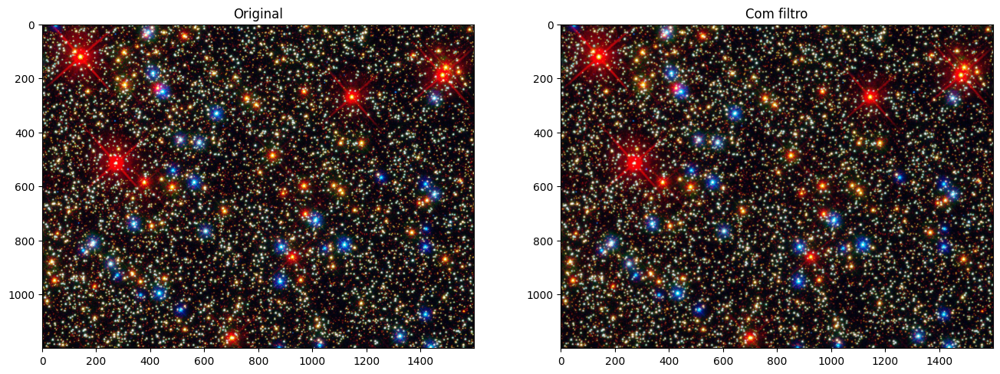

In [ ]:
conv_filter('/content/visao_computacional/lista1/stars.ppm', 5, low_pass_filter(5))

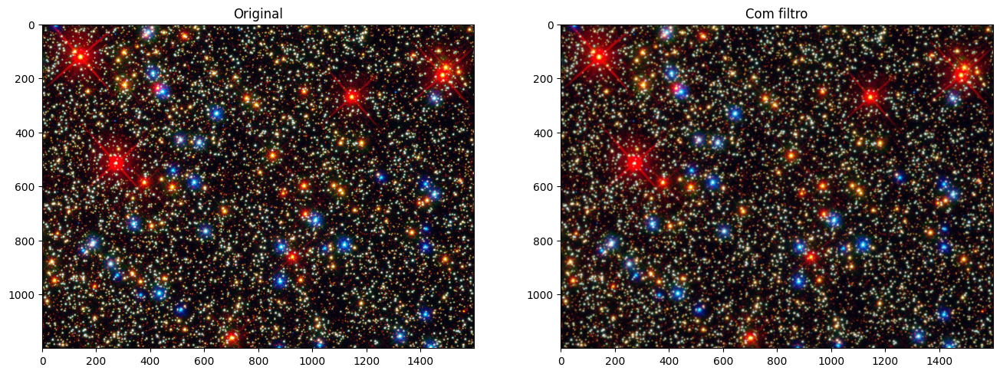

In [ ]:
conv_filter('/content/visao_computacional/lista1/stars.ppm', 8, low_pass_filter(8))

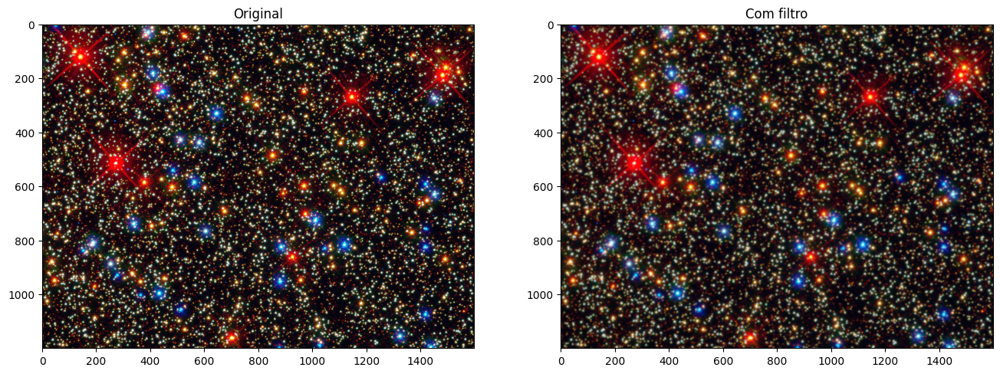

In [ ]:
conv_filter('/content/visao_computacional/lista1/stars.ppm', 11, low_pass_filter(11))

### **8.** Usando a função da questão 1, crie funções que apliquem filtros para calcular as imagens representando $\frac{∂f}{∂x}$, $\frac{∂f}{∂y}$ e $|∇f|$. Em seguida, implemente o operador de Sobel usando estas imagens como entrada. Exiba cada um desses resultados para três imagens distintas.

### Implementação

In [ ]:
def discrete_derivative_x(imagePPM):
  kernel = np.array([[1, 0, -1], [2, 0, -2], [1, 0, -1]])

  result = conv_filter(imagePPM, 3, kernel)

def discrete_derivative_y(imagePPM):
  kernel = np.array([[1, 2, 1], [0, 0, 0], [-1, -2, -1]])

  result = conv_filter(imagePPM, 3, kernel)

def sobel_operator(imagePPM):
    sobel_x = np.array([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]])
    sobel_y = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]])

    _, gradient_x, _ = conv(imagePPM, 3, sobel_x)
    img, gradient_y,_ = conv(imagePPM, 3, sobel_y)

    magnitude = np.sqrt(np.square(gradient_x.astype(np.uint64)) + np.square(gradient_y.astype(np.uint64)))
    magnitude = np.clip(magnitude, 0, 255).astype("uint8")

    plot_side_by_side(img, magnitude)

### Exemplo 1

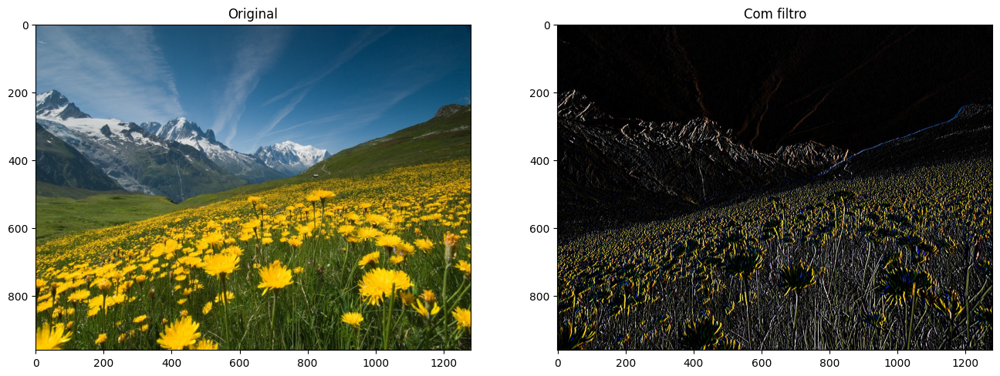

In [ ]:
discrete_derivative_x('/content/visao_computacional/lista1/flowers.ppm')

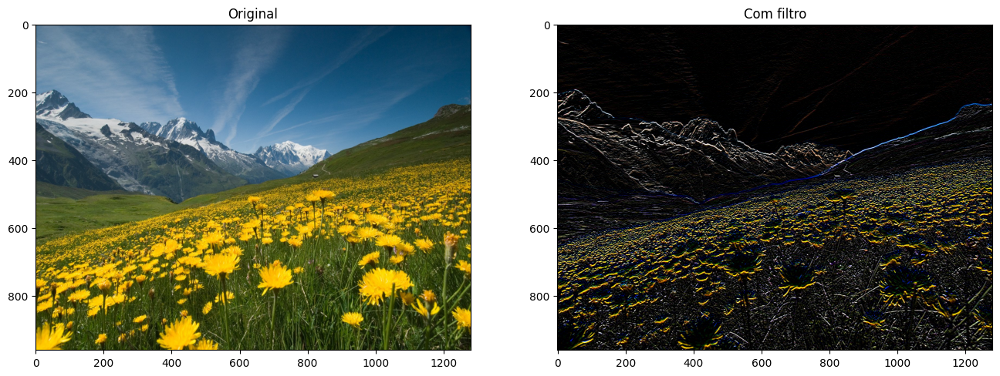

In [ ]:
discrete_derivative_y('/content/visao_computacional/lista1/flowers.ppm')

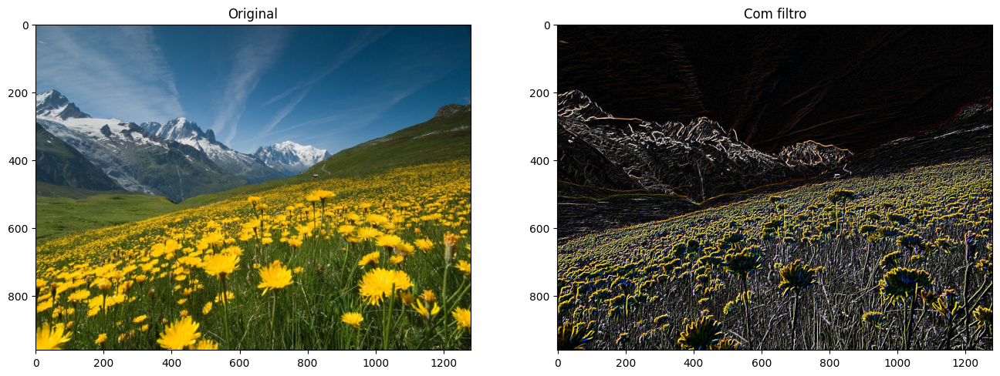

In [ ]:
sobel_operator('/content/visao_computacional/lista1/flowers.ppm')

### Exemplo 2

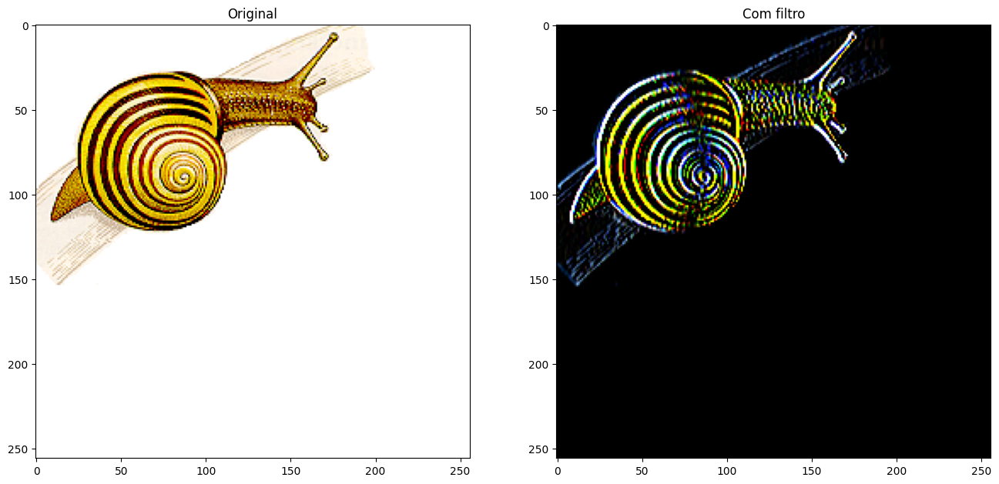

In [ ]:
discrete_derivative_x('/content/visao_computacional/lista1/snail.ppm')

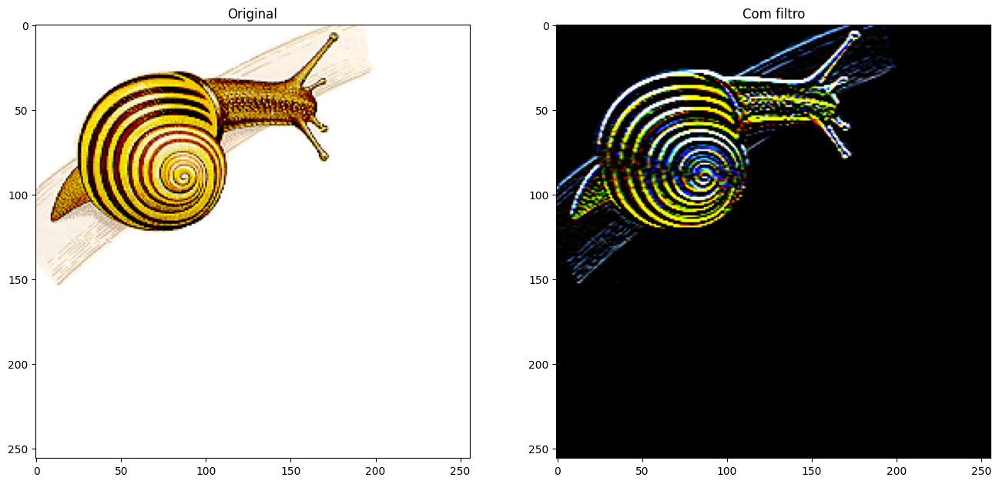

In [ ]:
discrete_derivative_y('/content/visao_computacional/lista1/snail.ppm')

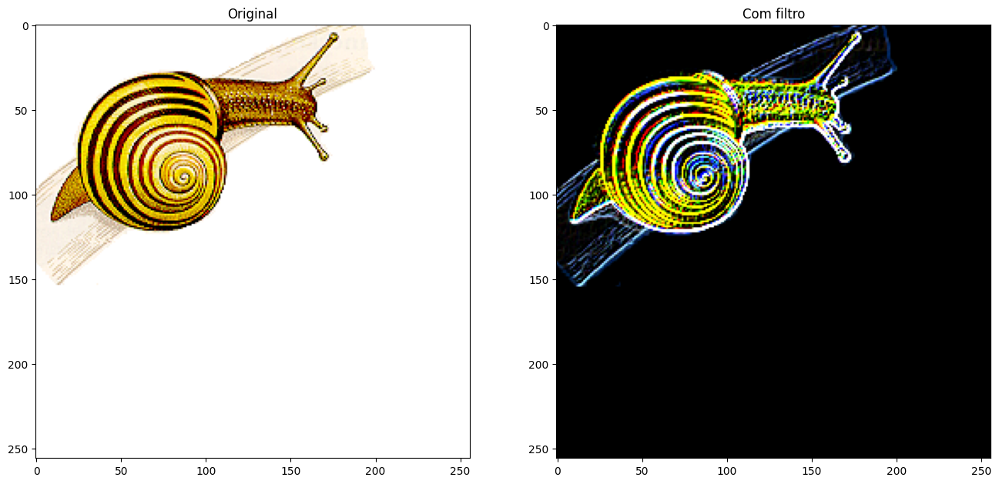

In [ ]:
sobel_operator('/content/visao_computacional/lista1/snail.ppm')

### Exemplo 3

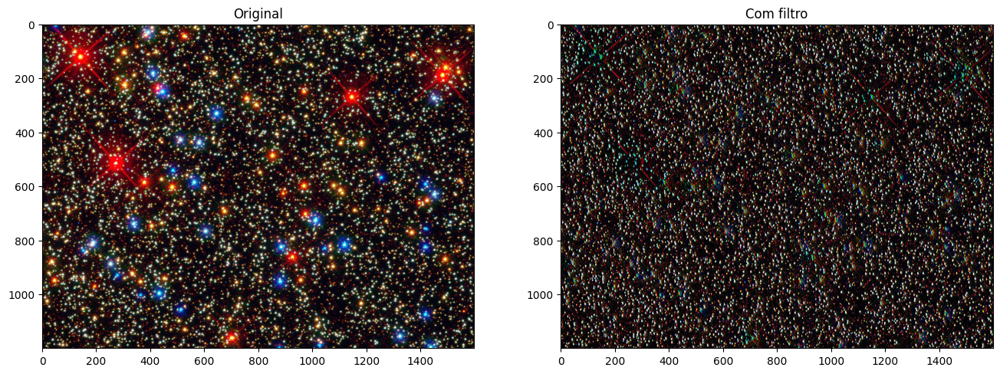

In [ ]:
discrete_derivative_x('/content/visao_computacional/lista1/stars.ppm')

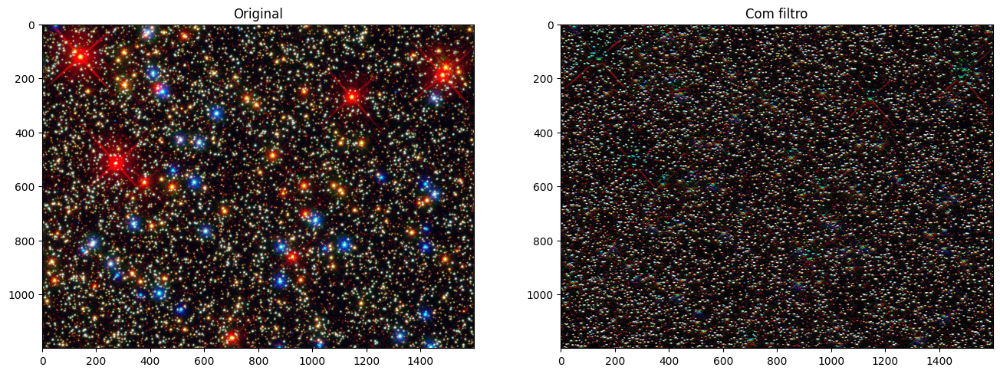

In [ ]:
discrete_derivative_y('/content/visao_computacional/lista1/stars.ppm')

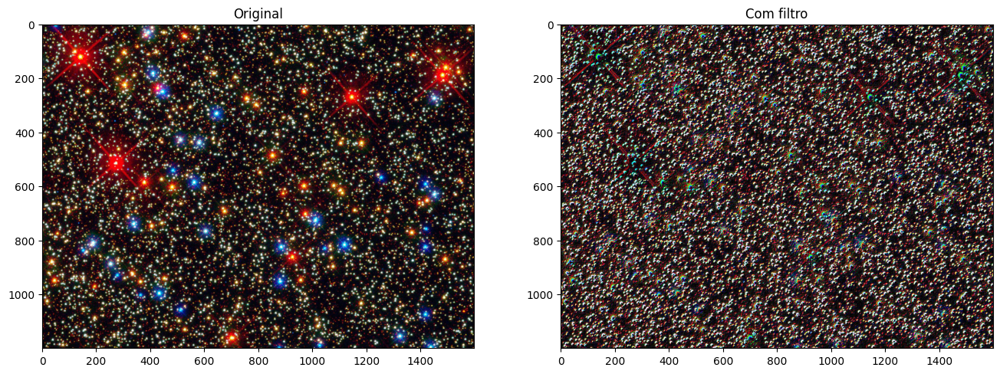

In [ ]:
sobel_operator('/content/visao_computacional/lista1/stars.ppm')